<a href="https://colab.research.google.com/github/asadimtiazmalik/FaceAlignmentandPoseEstimation/blob/main/Head_Pose_Estimation.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
!git clone https://github.com/vitoralbiero/img2pose.git

Cloning into 'img2pose'...
remote: Enumerating objects: 316, done.
remote: Counting objects: 100% (103/103), done.
remote: Compressing objects: 100% (77/77), done.
remote: Total 316 (delta 55), reused 51 (delta 26), pack-reused 213
Receiving objects: 100% (316/316), 15.41 MiB | 24.85 MiB/s, done.
Resolving deltas: 100% (144/144), done.


In [ ]:
%cd img2pose/

/content/img2pose


In [ ]:
!pip install -r requirements.txt

     |████████████████████████████████| 127 kB 5.3 MB/s 
     |████████████████████████████████| 97 kB 6.9 MB/s 
     |████████████████████████████████| 49 kB 5.3 MB/s 
     |████████████████████████████████| 145 kB 42.7 MB/s 
     |████████████████████████████████| 147 kB 47.5 MB/s 
     |████████████████████████████████| 402 kB 41.1 MB/s 
     |████████████████████████████████| 2.0 MB 31.5 MB/s 
     |████████████████████████████████| 114 kB 44.5 MB/s 
     |████████████████████████████████| 3.9 MB 33.6 MB/s 
     |████████████████████████████████| 119 kB 49.4 MB/s 
     |████████████████████████████████| 784 kB 43.7 MB/s 
     |████████████████████████████████| 121 kB 43.2 MB/s 
     |████████████████████████████████| 1.4 MB 37.4 MB/s 
     |████████████████████████████████| 125 kB 49.7 MB/s 
     |████████████████████████████████| 56 kB 4.1 MB/s 
     |████████████████████████████████| 108 kB 53.3 MB/s 
     |████████████████████████████████| 82 kB 1.2 MB/s 
     |█████████████████

In [ ]:
%cd Sim3DR

/content/img2pose/Sim3DR


In [ ]:
!sh build_sim3dr.sh

running build_ext
cythoning lib/rasterize.pyx to lib/rasterize.cpp
/usr/local/lib/python3.7/dist-packages/Cython/Compiler/Main.py:369: FutureWarning: Cython directive 'language_level' not set, using 2 for now (Py2). This will change in a later release! File: /content/img2pose/Sim3DR/lib/rasterize.pyx
  tree = Parsing.p_module(s, pxd, full_module_name)
building 'Sim3DR_Cython' extension
creating build
creating build/temp.linux-x86_64-3.7
creating build/temp.linux-x86_64-3.7/lib
x86_64-linux-gnu-gcc -pthread -Wno-unused-result -Wsign-compare -DNDEBUG -g -fwrapv -O2 -Wall -g -fdebug-prefix-map=/build/python3.7-LSlbJj/python3.7-3.7.11=. -fstack-protector-strong -Wformat -Werror=format-security -g -fdebug-prefix-map=/build/python3.7-LSlbJj/python3.7-3.7.11=. -fstack-protector-strong -Wformat -Werror=format-security -Wdate-time -D_FORTIFY_SOURCE=2 -fPIC -I/usr/local/lib/python3.7/dist-packages/numpy/core/include -I/usr/include/python3.7m -c lib/rasterize.cpp -o build/temp.linux-x86_64-3.7/li

In [ ]:
%cd ..

/content


In [ ]:
%cd img2pose/

/content/img2pose


In [ ]:
!unzip '/content/drive/MyDrive/Copy of models.zip'

Archive:  /content/drive/MyDrive/Copy of models.zip
   creating: models/
  inflating: models/WIDER_train_pose_mean_v1.npy  
  inflating: models/img2pose_v1.pth  
  inflating: models/WIDER_train_pose_stddev_v1.npy  


In [ ]:
import datetime
import tensorflow as tf

In [ ]:
current_time = datetime.datetime.now().strftime("%Y%m%d-%H%M%S")
log_dir = 'logs/' + current_time + '/movements'

movement_summary_writer = tf.summary.create_file_writer(log_dir)


In [ ]:
pwd

'/content/img2pose'

In [ ]:
%pwd

'/content/img2pose'

In [ ]:
!python test_images.py

Model will use 1 GPUs!
[array([-0.21085297,  0.24347633, -0.14813301, -0.62615591, -0.01609521,
        8.67739296])]
Figure(800x800)

Traceback (most recent call last):
  File "test_images.py", line 78, in <module>
    img = Image.open(img_path).convert("RGB")
  File "/usr/local/lib/python3.7/dist-packages/PIL/Image.py", line 2891, in open
    fp = builtins.open(filename, "rb")
IsADirectoryError: [Errno 21] Is a directory: '/content/img2pose/test_images/.ipynb_checkpoints'


In [ ]:
%cd ..

/content/img2pose


In [ ]:
!pip install matplotlib==3.1.1

     |███████████████▍                | 6.3 MB 4.7 MB/s eta 0:00:02

In [ ]:
import numpy as np
import torch
from torchvision import transforms
from matplotlib import pyplot as plt
from tqdm.notebook import tqdm
from PIL import Image, ImageOps
import matplotlib.patches as patches
from scipy.spatial.transform import Rotation
import pandas as pd
from scipy.spatial import distance
import time
import os
import math
import scipy.io as sio
from utils.renderer import Renderer
from utils.image_operations import expand_bbox_rectangle
from utils.pose_operations import get_pose
from img2pose import img2poseModel
from model_loader import load_model

def render_plot(img, poses, bboxes):
    (w, h) = img.size
    image_intrinsics = np.array([[w + h, 0, w // 2], [0, w + h, h // 2], [0, 0, 1]])
    
    trans_vertices = renderer.transform_vertices(img, poses)
    img = renderer.render(img, trans_vertices, alpha=1)    

    plt.figure(figsize=(8, 8))     
    
    for bbox in bboxes:
        plt.gca().add_patch(patches.Rectangle((bbox[0], bbox[1]), bbox[2] - bbox[0], bbox[3] - bbox[1],linewidth=3,edgecolor='b',facecolor='none'))            
    
    plt.imshow(img)        
    plt.show()


renderer = Renderer(
    vertices_path="../../pose_references/vertices_trans.npy", 
    triangles_path="../../pose_references/triangles.npy"
)

threed_points = np.load('../../pose_references/reference_3d_68_points_trans.npy')


transform = transforms.Compose([transforms.ToTensor()])

DEPTH = 18
MAX_SIZE = 1400
MIN_SIZE = 600

POSE_MEAN = "../../models/WIDER_train_pose_mean_v1.npy"
POSE_STDDEV = "../../models/WIDER_train_pose_stddev_v1.npy"
MODEL_PATH = "../../models/img2pose_v1.pth"

pose_mean = np.load(POSE_MEAN)
pose_stddev = np.load(POSE_STDDEV)

img2pose_model = img2poseModel(
    DEPTH, MIN_SIZE, MAX_SIZE, 
    pose_mean=pose_mean, pose_stddev=pose_stddev,
    threed_68_points=threed_points,
)
load_model(img2pose_model.fpn_model, MODEL_PATH, cpu_mode=str(img2pose_model.device) == "cpu", model_only=True)
img2pose_model.evaluate()

# change to a folder with images, or another list containing image paths
images_path = "your_own_image_folder/list"

threshold = 0.9

if os.path.isfile(images_path):
    img_paths = pd.read_csv(images_path, delimiter=" ", header=None)
    img_paths = np.asarray(img_paths).squeeze()
else:
    img_paths = [os.path.join(images_path, img_path) for img_path in os.listdir(images_path)]

for img_path in tqdm(img_paths):
    img = Image.open(img_path).convert("RGB")
    
    image_name = os.path.split(img_path)[1]
    
    (w, h) = img.size
    image_intrinsics = np.array([[w + h, 0, w // 2], [0, w + h, h // 2], [0, 0, 1]])
            
    res = img2pose_model.predict([transform(img)])[0]

    all_bboxes = res["boxes"].cpu().numpy().astype('float')

    poses = []
    bboxes = []
    for i in range(len(all_bboxes)):
        if res["scores"][i] > threshold:
            bbox = all_bboxes[i]
            pose_pred = res["dofs"].cpu().numpy()[i].astype('float')
            pose_pred = pose_pred.squeeze()

            poses.append(pose_pred)  
            bboxes.append(bbox)

    render_plot(img.copy(), poses, bboxes)




In [ ]:
!nvidia-smi

Wed Aug 25 16:23:11 2021       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 470.57.02    Driver Version: 460.32.03    CUDA Version: 11.2     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Tesla T4            Off  | 00000000:00:04.0 Off |                    0 |
| N/A   40C    P8     9W /  70W |      0MiB / 15109MiB |      0%      Default |
|                               |                      |                  N/A |
+-------------------------------+----------------------+----------------------+
                                                                               
+-------

In [ ]:

    whenet = WHENet(snapshot=args.snapshot)
    yolo = YOLO(**vars(args))
    VIDEO_SRC = 0 if args.video == '' else args.video # if video clip is passed, use web cam
    cap = cv2.VideoCapture(VIDEO_SRC)
    print('cap info',VIDEO_SRC)
    ret, frame = cap.read()
    fourcc = cv2.VideoWriter_fourcc(*'MJPG')
    out = cv2.VideoWriter('output.avi', fourcc, 30, (frame.shape[1], frame.shape[0]))  # write the result to a video

    while True:
        try:
            ret, frame = cap.read()
        except:
            break
        frame_rgb = cv2.cvtColor(frame, cv2.COLOR_BGR2RGB)
        img_pil = Image.fromarray(frame_rgb)
        bboxes, scores, classes = yolo.detect(img_pil)
        for bbox in bboxes:
            frame = process_detection(whenet, frame, bbox, args)
        cv2.imshow('output',frame)
        out.write(frame)
        key = cv2.waitKey(1) & 0xFF
        if key == ord("q"):
            break

    # cleanup
    cap.release()
    cv2.destroyAllWindows()

In [ ]:
from scipy.spatial.transform import Rotation
from scipy.spatial import distance

def convert_to_aflw(rotvec, is_rotvec=True):
    if is_rotvec:
        rotvec = Rotation.from_rotvec(rotvec).as_matrix()
    rot_mat_2 = np.transpose(rotvec)
    angle = Rotation.from_matrix(rot_mat_2).as_euler('xyz', degrees=True)
    
    return np.array([angle[0], -angle[1], -angle[2]])

Downloading: "https://download.pytorch.org/models/resnet18-5c106cde.pth" to /root/.cache/torch/hub/checkpoints/resnet18-5c106cde.pth



Model will use 1 GPUs!
cap info /content/correct_detection.mp4


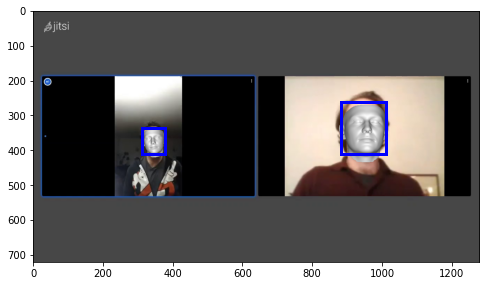

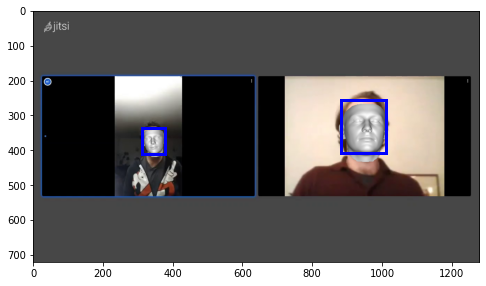

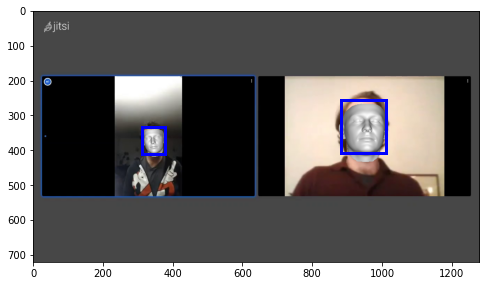

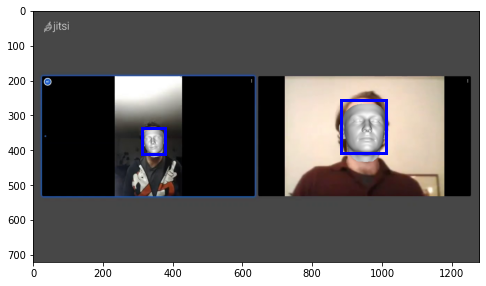

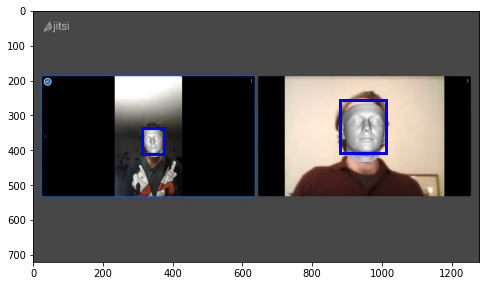

...

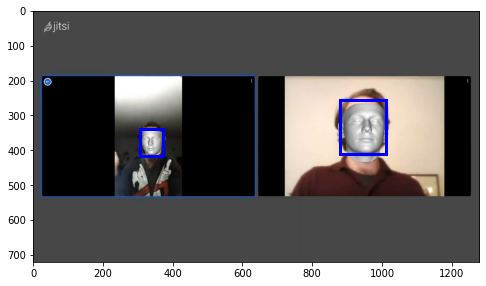

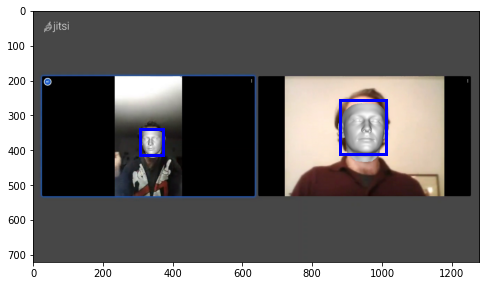

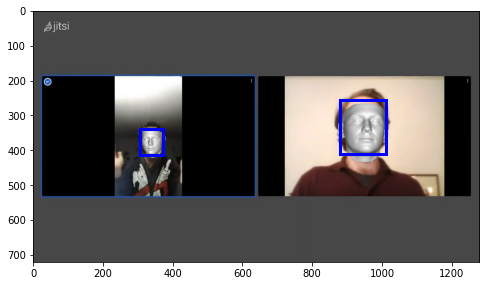

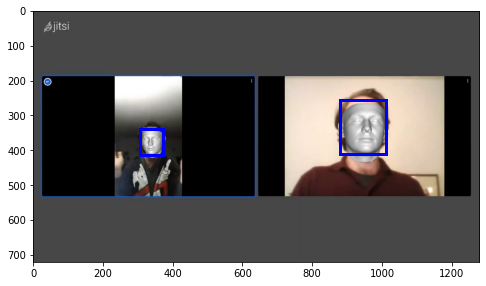

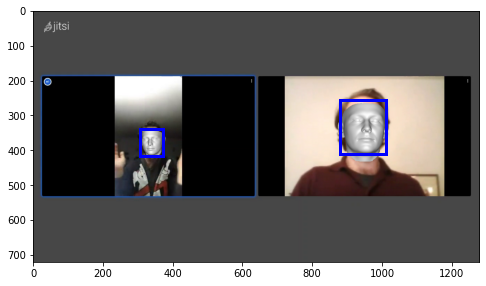

error: ignored

In [ ]:
import numpy as np
import torch
import cv2
from torchvision import transforms
from matplotlib import pyplot as plt
from tqdm.notebook import tqdm
from PIL import Image, ImageOps
import matplotlib.patches as patches
from scipy.spatial.transform import Rotation
import pandas as pd
from scipy.spatial import distance
import time
import os
import math
import scipy.io as sio
from utils.renderer import Renderer
from utils.image_operations import expand_bbox_rectangle
from utils.pose_operations import get_pose
from img2pose import img2poseModel
from model_loader import load_model

def render_plot(img, poses, bboxes):
    (w, h) = img.size
    image_intrinsics = np.array([[w + h, 0, w // 2], [0, w + h, h // 2], [0, 0, 1]])
    
    trans_vertices = renderer.transform_vertices(img, poses)
    img = renderer.render(img, trans_vertices, alpha=1)    

    plt.figure(figsize=(8, 8))     
    
    for bbox in bboxes:
        plt.gca().add_patch(patches.Rectangle((bbox[0], bbox[1]), bbox[2] - bbox[0], bbox[3] - bbox[1],linewidth=3,edgecolor='b',facecolor='none'))            

    
    plt.imshow(img)        
    plt.show()

    return img


renderer = Renderer(
    vertices_path="/content/img2pose/pose_references/vertices_trans.npy", 
    triangles_path="/content/img2pose/pose_references/triangles.npy"
)

threed_points = np.load('/content/img2pose/pose_references/reference_3d_68_points_trans.npy')


transform = transforms.Compose([transforms.ToTensor()])

DEPTH = 18
MAX_SIZE = 1400
MIN_SIZE = 600

POSE_MEAN = "/content/models/WIDER_train_pose_mean_v1.npy"
POSE_STDDEV = "/content//models/WIDER_train_pose_stddev_v1.npy"
MODEL_PATH = "/content/models/img2pose_v1.pth"

pose_mean = np.load(POSE_MEAN)
pose_stddev = np.load(POSE_STDDEV)

img2pose_model = img2poseModel(
    DEPTH, MIN_SIZE, MAX_SIZE, 
    pose_mean=pose_mean, pose_stddev=pose_stddev,
    threed_68_points=threed_points,
)
load_model(img2pose_model.fpn_model, MODEL_PATH, cpu_mode=str(img2pose_model.device) == "cpu", model_only=True)
img2pose_model.evaluate()

# change to a folder with images, or another list containing image paths
images_path = "/content/img2pose/test_images"

threshold = 0.9

# if os.path.isfile(images_path):
#     img_paths = pd.read_csv(images_path, delimiter=" ", header=None)
#     img_paths = np.asarray(img_paths).squeeze()
# else:
#     img_paths = [os.path.join(images_path, img_path) for img_path in os.listdir(images_path)]


video_path = '/content/correct_detection.mp4'
img_path = '/content/img2pose/test_images/test.jpg'

cap = cv2.VideoCapture(video_path)
print('cap info',video_path)
ret, frame = cap.read()
fourcc = cv2.VideoWriter_fourcc(*'MJPG')
out = cv2.VideoWriter('output.avi', fourcc, 10, (frame.shape[1], frame.shape[0]))  # write the result to a video
p = []
y = []
r = []
frame_id = 0
while True:
    try:
        ret, frame = cap.read()
    except:
        break
    frame_rgb = cv2.cvtColor(frame, cv2.COLOR_BGR2RGB)
    img = Image.fromarray(frame_rgb)
    
    (w, h) = img.size
   
    image_intrinsics = np.array([[w + h, 0, w // 2], [0, w + h, h // 2], [0, 0, 1]])
    res = img2pose_model.predict([transform(img)])[0]    
    all_bboxes = res["boxes"].cpu().numpy().astype('float')
   
    poses = []
    bboxes = []
    for i in range(len(all_bboxes)):
      if res["scores"][i] > threshold:
        bbox = all_bboxes[i]
        pose_pred = res["dofs"].cpu().numpy()[i].astype('float')
        pose_pred = pose_pred.squeeze()

        poses.append(pose_pred)  
        bboxes.append(bbox)
    
    frame = render_plot(img.copy(), poses, bboxes)

    for i, pose in enumerate(poses):
      # pitch, yaw, roll, _, _, scale = pose
      
      if(i == 1):
        pose[:3] = convert_to_aflw(pose[:3])
        pitch, yaw, roll, _, _, scale = pose
        p.append(pitch)
        y.append(yaw)
        r.append(roll)
        tf.summary.scalar('yaw', yaw, step=frame_id)
        tf.summary.scalar('pitch', pitch, step=frame_id)
        tf.summary.scalar('roll', pitch, step=frame_id)

    
    

    #cv2.imshow('output',frame)
    out.write(frame)
    frame_id+=1
    key = cv2.waitKey(1) & 0xFF
    if key == ord("q"):
        break

# cleanup
cap.release()
cv2.destroyAllWindows()
# img = Image.open(img_path).convert("RGB")
    
# image_name = os.path.split(img_path)[1]
    
# (w, h) = img.size
# image_intrinsics = np.array([[w + h, 0, w // 2], [0, w + h, h // 2], [0, 0, 1]])
            
# res = img2pose_model.predict([transform(img)])[0]

# all_bboxes = res["boxes"].cpu().numpy().astype('float')

# poses = []
# bboxes = []
# for i in range(len(all_bboxes)):
#     if res["scores"][i] > threshold:
#         bbox = all_bboxes[i]
#         pose_pred = res["dofs"].cpu().numpy()[i].astype('float')
#         pose_pred = pose_pred.squeeze()

#         poses.append(pose_pred)  
#         bboxes.append(bbox)

# render_plot(img.copy(), poses, bboxes)

In [ ]:
from math import sin, cos
import tensorflow as tf


In [ ]:
def draw_axis(img, yaw, pitch, roll, tdx=None, tdy=None, size=50):
    yaw = -yaw

    if tdx != None and tdy != None:
        tdx = tdx
        tdy = tdy
    else:
        height, width = img.shape[:2]
        tdx = width / 2
        tdy = height / 2

    # X-Axis pointing to right drawn in red
    x1 = size * (cos(yaw) * cos(roll)) + tdx
    y1 = size * (cos(pitch) * sin(roll) + cos(roll) * sin(pitch) * sin(yaw)) + tdy

    # Y-Axis | drawn in green
    x2 = size * (-cos(yaw) * sin(roll)) + tdx
    y2 = size * (cos(pitch) * cos(roll) - sin(pitch) * sin(yaw) * sin(roll)) + tdy

    # Z-Axis (out of the screen) drawn in blue
    x3 = size * (sin(yaw)) + tdx
    y3 = size * (-cos(yaw) * sin(pitch)) + tdy

    cv2.line(img, (int(tdx), int(tdy)), (int(x1),int(y1)),(0,0,255),3)
    cv2.line(img, (int(tdx), int(tdy)), (int(x2),int(y2)),(0,255,0),3)
    cv2.line(img, (int(tdx), int(tdy)), (int(x3),int(y3)),(255,0,0),2)

    return img

In [ ]:
print(y)

[2.5016026427289795, 2.837176656684347, 4.171322136230224, 4.546826220284483, 3.0938192624262286, 3.837817842339753, 3.4791300081587155, 2.576383206163125, 2.9103439656342807, 3.480772048447302, 3.410311507555524, 3.141108515044967, 3.8704740785687766, 2.9860552031219174, 2.361057680283001, 2.933236521976355, 2.6421175694905426, 1.8081053214434357, 1.664802843566169, 0.8876933795390334, 2.1121978472289618, 2.8090265301904576, 1.3746914366709504, 1.8125688367451762, 1.9017384366756656, 2.037986122822756, 2.1197247702765143, 2.05604095328178, 1.964943888234494, 1.6468777192211497, 2.39022106183768, 3.0269795018940258, 3.2593045195115824, 1.7917173035981409, 0.5103115606650643, -1.8745663990134336, -0.15098985545833063, -1.4071883048761802, -1.0715444117651893, -0.3720480715569932, 0.13434393630841873, 0.3877539634821949, -0.27498882701052446, -0.1837568074392298, -0.19671031766056418, -0.8224737992880422, -0.6361658291220189, 1.3278516134439067, 1.420135676802826, 1.332368446193712, 1.45

With a human head facing the camera, 
1.   Yaw is the angle of moving the head left and right
2.   Pitch is that of moving the head up and down
3.   Roll is the tilt angle  





In [ ]:
p[511]

-3.5293743992537654

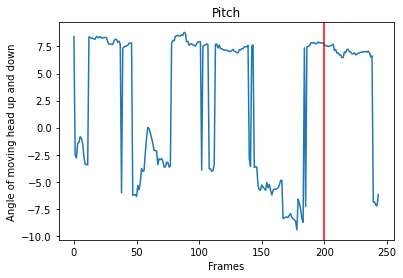

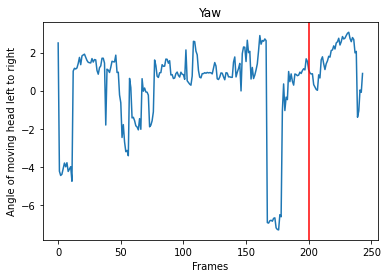

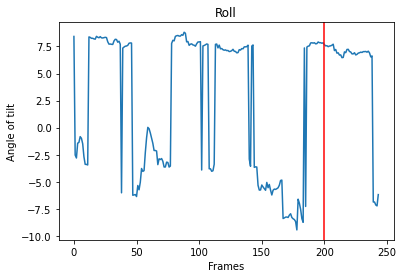

In [ ]:
plt.plot(p)
plt.axvline(200, -8, 2, color = 'r')
plt.title('Pitch')
plt.xlabel('Frames')
plt.ylabel('Angle of moving head up and down')
plt.show()

plt.plot(y)
plt.axvline(200, -2, 5, color = 'r')
plt.title('Yaw')
plt.xlabel('Frames')
plt.ylabel('Angle of moving head left to right')
plt.show()

plt.plot(p)
plt.axvline(200, -8, 2, color = 'r')
plt.title('Roll')
plt.xlabel('Frames')
plt.ylabel('Angle of tilt')
plt.show()


In [ ]:
                       !sudo apt-get install python3-matplotlib

Reading package lists... Done
Building dependency tree       
Reading state information... Done
The following package was automatically installed and is no longer required:
  libnvidia-common-460
Use 'sudo apt autoremove' to remove it.
The following additional packages will be installed:
  fonts-lyx javascript-common libjs-jquery libjs-jquery-ui
  python-matplotlib-data python3-cycler python3-dateutil python3-numpy
  python3-olefile python3-pil python3-pyparsing python3-six python3-tz
  ttf-bitstream-vera
Suggested packages:
  apache2 | lighttpd | httpd libjs-jquery-ui-docs python-cycler-doc dvipng
  gir1.2-gtk-3.0 ghostscript inkscape ipython3 python-matplotlib-doc
  python3-cairocffi python3-gi-cairo python3-gobject python3-nose
  python3-pyqt4 python3-scipy python3-sip python3-tornado texlive-extra-utils
  texlive-latex-extra ttf-staypuft python-numpy-doc python3-numpy-dbg
  python-pil-doc python3-pil-dbg python-pyparsing-doc
The following NEW packages will be installed:
  fonts-lyx

In [ ]:
import numpy as np
import torch
import cv2
import json
from torchvision import transforms
from matplotlib import pyplot as plt
from tqdm.notebook import tqdm
from PIL import Image, ImageOps
import matplotlib.patches as patches
from scipy.spatial.transform import Rotation
import pandas as pd
from scipy.spatial import distance
import time
import os
import math
import scipy.io as sio
from utils.renderer import Renderer
from utils.image_operations import expand_bbox_rectangle
from utils.pose_operations import get_pose
from img2pose import img2poseModel
from model_loader import load_model

def render_plot(img, poses, bboxes):
    (w, h) = img.size
    image_intrinsics = np.array([[w + h, 0, w // 2], [0, w + h, h // 2], [0, 0, 1]])
    
    trans_vertices = renderer.transform_vertices(img, poses)
    print(trans_vertices)
    img = renderer.render(img, trans_vertices, alpha=1)    

    # plt.figure(figsize=(8, 8))     
    
    # for bbox in bboxes:
    #     plt.gca().add_patch(patches.Rectangle((bbox[0], bbox[1]), bbox[2] - bbox[0], bbox[3] - bbox[1],linewidth=3,edgecolor='b',facecolor='none'))            
    # print('R')
    
    # plt.imshow(img)        
    # plt.show()

    return img


renderer = Renderer(
    vertices_path="/content/img2pose/pose_references/vertices_trans.npy", 
    triangles_path="/content/img2pose/pose_references/triangles.npy"
)

threed_points = np.load('/content/img2pose/pose_references/reference_3d_68_points_trans.npy')


transform = transforms.Compose([transforms.ToTensor()])

DEPTH = 18
MAX_SIZE = 1400
MIN_SIZE = 600

POSE_MEAN = "/content/models/WIDER_train_pose_mean_v1.npy"
POSE_STDDEV = "/content/models/WIDER_train_pose_stddev_v1.npy"
MODEL_PATH = "/content/models/img2pose_v1.pth"

pose_mean = np.load(POSE_MEAN)
pose_stddev = np.load(POSE_STDDEV)

img2pose_model = img2poseModel(
    DEPTH, MIN_SIZE, MAX_SIZE, 
    pose_mean=pose_mean, pose_stddev=pose_stddev,
    threed_68_points=threed_points,
)
load_model(img2pose_model.fpn_model, MODEL_PATH, cpu_mode=str(img2pose_model.device) == "cpu", model_only=True)
img2pose_model.evaluate()

# change to a folder with images, or another list containing image paths
images_path = "/content/img2pose/test_images"

threshold = 0.9

# if os.path.isfile(images_path):
#     img_paths = pd.read_csv(images_path, delimiter=" ", header=None)
#     img_paths = np.asarray(img_paths).squeeze()
# else:
#     img_paths = [os.path.join(images_path, img_path) for img_path in os.listdir(images_path)]


video_path = '/content/incorrect_5.mp4'
img_path = '/content/img2pose/test_images/test.jpg'

cap = cv2.VideoCapture(video_path)
print('cap info',video_path)
ret, frame = cap.read()
fourcc = cv2.VideoWriter_fourcc(*'MJPG')
out = cv2.VideoWriter('output_correct.avi', fourcc, 30, (frame.shape[1], frame.shape[0]))  # write the result to a video
json_result={}
frame_id = 0
while True:
    try:
        ret, frame = cap.read()
    except:
        break
    # detections = []
    frame_rgb = cv2.cvtColor(frame, cv2.COLOR_BGR2RGB)
    img = Image.fromarray(frame_rgb)
    
    (w, h) = img.size
   
    image_intrinsics = np.array([[w + h, 0, w // 2], [0, w + h, h // 2], [0, 0, 1]])
    res = img2pose_model.predict([transform(img)])[0]    
    all_bboxes = res["boxes"].cpu().numpy().astype('float')
   
    poses = []
    bboxes = []
    for i in range(len(all_bboxes)):
      if res["scores"][i] > threshold:
        bbox = all_bboxes[i]
        pose_pred = res["dofs"].cpu().numpy()[i].astype('float')
        pose_pred = pose_pred.squeeze()
        poses.append(pose_pred)  
        bboxes.append(bbox)
    
    rendered_frame = render_plot(img.copy(), poses, bboxes)

    for i, pose in enumerate(poses):
      bbox = bboxes[i]
      pitch, yaw, roll, _, _, scale = pose
      tf.summary.scalar('yaw', yaw, step=frame_id)
      tf.summary.scalar('pitch', pitch, step=frame_id)
      tf.summary.scalar('roll', pitch, step=frame_id)
      tdx = bbox[0] + ((bbox[2] - bbox[0]) / 2)
      tdy = bbox[1] + ((bbox[3] - bbox[1]) / 2)
      rendered_frame = draw_axis(np.asarray(rendered_frame), yaw, pitch, roll, tdx=tdx, tdy=tdy, size=1000 / scale)

    result = {
         'pose': [p.tolist() for p in poses]
      }
      
    json_result[frame_id] = result


    


    with open('/content/result.json', 'w') as json_file:
      json.dump(json_result, json_file, indent=2)
    
    

    #cv2.imshow('output',frame)
    plt.imshow(rendered_frame)
    plt.show()
    out.write(rendered_frame)
    frame_id += 1
    key = cv2.waitKey(1) & 0xFF
    if key == ord("q"):
        break

# cleanup
cap.release()
cv2.destroyAllWindows()
# img = Image.open(img_path).convert("RGB")
    
# image_name = os.path.split(img_path)[1]
    
# (w, h) = img.size
# image_intrinsics = np.array([[w + h, 0, w // 2], [0, w + h, h // 2], [0, 0, 1]])
            
# res = img2pose_model.predict([transform(img)])[0]

# all_bboxes = res["boxes"].cpu().numpy().astype('float')

# poses = []
# bboxes = []
# for i in range(len(all_bboxes)):
#     if res["scores"][i] > threshold:
#         bbox = all_bboxes[i]
#         pose_pred = res["dofs"].cpu().numpy()[i].astype('float')
#         pose_pred = pose_pred.squeeze()

#         poses.append(pose_pred)  
#         bboxes.append(bbox)

# render_plot(img.copy(), poses, bboxes)

In [ ]:
%cd img2pose/

/content/img2pose


In [ ]:
%load_ext tensorboard
%tensorboard --logdir /content/logs/20210901-222049/movements

<IPython.core.display.Javascript object>